#### ......Continued from project3_Notebook1

### Contents:
- [Importing necessary libraries](#Importing-necessary-libraries)
- [4. Data Cleaning and Exploratory Data Analysis (EDA)](#Data-Cleaning-and-Exploratory-Data-Analysis)
- [5. Preparation of master dataset](#Preparation-of-master-dataset)
- [6. Preprocessing and Modelling](#Preprocessing-and-Modelling)
    - [i. Tokenisation, Lemmatisation and Stemming](#Tokenisation,-Lemmatisation-and-Stemming)
- [7. Train-test-split of data for model design](#Train-test-split-of-data-for-model-design)
    - [ i. Applying Gridsearch for Count Vectorizer along with Logistic Regression to get optimum values for parameters](#Applying-Gridsearch-for-Count-Vectorizer-along-with-Logistic-Regression-to-get-optimum-values-for-parameters)
    - [ii. Applying Count Vectorizer using optimum values for parameters](#Applying-Count-Vectorizer-using-optimum-values-for-parameters)
    - [iii. Applying Gridsearch for Tfidf Vectorizer along with Logistic Regression to get optimum values for parameters](#Applying-Gridsearch-for-Tfidf-Vectorizer-along-with-Logistic-Regression-to-get-optimum-values-for-parameters)
    - [iv. Applying Tfidf Vectorizer](#Applying-Tfidf-Vectorizer)
    - [v. Evaluating model](#Evaluating-models)
        - [ a. Applying Naive Bayes along with Count Vectorizer (CV)](#Applying-Naive-Bayes-along-with-Count-Vectorizer-(CV))
        - [b. Applying Naive Bayes along with Tfidf Vectorizer](#Applying-Naive-Bayes-along-with-Tfidf-Vectorizer)
        - [c. Applying Decision Tree Classifier with Count Vectorizer](#Applying-Decision-Tree-Classifier-with-Count-Vectorizer)
        - [d. Applying Decision Tree with TFIDF](#Applying-Decision-Tree-with-TFIDF)
- [8. Evaluation of models and selection of model for prediction](#Evaluation-of-Ensemble-models-and-selection-of-model-for-prediction)
- [9. Conclusions and application of selected model](#Conclusions-and-application-of-selected-model)

### Importing necessary libraries 

In [74]:
# Standard data science imports:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score 
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score 
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_extraction import stop_words, text
import requests
import graphviz
from sklearn.externals.six import StringIO
from IPython.display import Image
from sklearn.tree import export_graphviz
import pydotplus

import time
import random
import regex as re
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
import nltk

from nltk.tokenize import RegexpTokenizer

In [75]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', -1)

## 4. Data Cleaning and Exploratory Data Analysis (EDA)


### Data was retrieved from the csv files for both subreddits ('vegetarian.csv') and ('lowimpactlifestyle.csv')  and checked for duplicates and null values as part of the EDA. 

### An additional column was created combining 'title' and 'selftext' to allow for better training of the model

### i. Getting data from vegetarian.csv and examination of data


In [76]:
#getting data from csv file

veg_posts=pd.read_csv('../datasets/vegetarian.csv')
veg_posts.head()

,all_awardings,allow_live_comments,approved_at_utc,approved_by,archived,author,author_cakeday,author_flair_background_color,author_flair_css_class,author_flair_richtext,author_flair_template_id,author_flair_text,author_flair_text_color,author_flair_type,author_fullname,author_patreon_flair,awarders,banned_at_utc,banned_by,can_gild,can_mod_post,category,clicked,content_categories,contest_mode,created,created_utc,crosspost_parent,crosspost_parent_list,discussion_type,distinguished,domain,downs,edited,gilded,gildings,hidden,hide_score,id,is_crosspostable,is_meta,is_original_content,is_reddit_media_domain,is_robot_indexable,is_self,is_video,likes,link_flair_background_color,link_flair_css_class,link_flair_richtext,link_flair_template_id,link_flair_text,link_flair_text_color,link_flair_type,locked,media,media_embed,media_metadata,media_only,mod_note,mod_reason_by,mod_reason_title,mod_reports,name,no_follow,num_comments,num_crossposts,num_reports,over_18,parent_whitelist_status,permalink,pinned,post_hint,preview,pwls,quarantine,removal_reason,report_reasons,saved,score,secure_media,secure_media_embed,selftext,selftext_html,send_replies,spoiler,steward_reports,stickied,subreddit,subreddit_id,subreddit_name_prefixed,subreddit_subscribers,subreddit_type,suggested_sort,thumbnail,thumbnail_height,thumbnail_width,title,total_awards_received,ups,url,user_reports,view_count,visited,whitelist_status,wls
0,[],False,NaN,NaN,False,AutoModerator,NaN,NaN,NaN,[],NaN,NaN,NaN,text,t2_6l4z3,False,[],NaN,NaN,False,False,NaN,False,NaN,False,1.571080e+09,1.571051e+09,NaN,NaN,NaN,moderator,self.vegetarian,0,False,0,{},False,False,dhp1ef,False,False,False,False,True,True,False,NaN,NaN,NaN,[],NaN,NaN,dark,text,False,NaN,{},NaN,False,NaN,NaN,NaN,[],t3_dhp1ef,True,14,0,NaN,False,all_ads,/r/vegetarian/comments/dhp1ef/whats_for_dinner_discussion/,False,NaN,NaN,6,False,NaN,NaN,False,3,NaN,{},"Welcome to our weekly discussion on what you’re having for dinner. Feel free to discuss what you are making for dinner this week, what you ate, recipes and pictures of your latest concoctions. If you are unsure of what to do with the ingredients you have on hand, this is the place to ask. Grocery store hauls welcome!","&lt;!-- SC_OFF --&gt;&lt;div class=""md""&gt;&lt;p&gt;Welcome to our weekly discussion on what you’re having for dinner. Feel free to discuss what you are making for dinner this week, what you ate, recipes and pictures of your latest concoctions. If you are unsure of what to do with the ingredients you have on hand, this is the place to ask. Grocery store hauls welcome!&lt;/p&gt;\n&lt;/div&gt;&lt;!-- SC_ON --&gt;",False,False,[],True,vegetarian,t5_2qm7x,r/vegetarian,186568,public,NaN,self,NaN,NaN,What's for Dinner? Discussion,0,3,https://www.reddit.com/r/vegetarian/comments/dhp1ef/whats_for_dinner_discussion/,[],NaN,False,all_ads,6
1,[],False,NaN,NaN,False,AutoModerator,NaN,NaN,NaN,[],NaN,NaN,NaN,text,t2_6l4z3,False,[],NaN,NaN,False,False,NaN,False,NaN,False,1.571339e+09,1.571310e+09,NaN,NaN,NaN,moderator,self.vegetarian,0,False,0,{},False,False,dj4tli,False,False,False,False,True,True,False,NaN,NaN,NaN,[],NaN,NaN,dark,text,False,NaN,{},NaN,False,NaN,NaN,NaN,[],t3_dj4tli,True,0,0,NaN,False,all_ads,/r/vegetarian/comments/dj4tli/meal_prepping_and_tips/,False,NaN,NaN,6,False,NaN,NaN,False,1,NaN,{},"Welcome to our weekly discussion on meal-prepping. Feel free to ask questions, post pictures and recipes, and to discuss anything and everything related to meal-prepping. You can also use this discussion to share general tips you have – whether it is a great app that you love, cooking techniques, or vegetarianism in general.","&lt;!-- SC_OFF --&gt;&lt;div class=""md""&gt;&lt;p&gt;Welcome to our weekly discussion on meal-prepping. Feel free to ask questions, post pictures and recipes, and to discuss anything and everything related to meal-prepping. You can also use this discussion to share general tips you have – whether it is a great app that you love, cooking techni

In [77]:
#size of dataframe 

veg_posts.shape

(1492, 106)

In [78]:
# checking for duplicates and retaining first

veg_posts[veg_posts.duplicated(['selftext'])] [['name', 'selftext']].sort_values(by='selftext')

,name,selftext
971,t3_dgy2cv,"\n I would like to find a way to buy larger amounts of Morningstar, Boca, Gardein, Lightlife, Tofurkey ,etc products. I've been vegetarian for decades and I still buy the basic 4 packs of these products. \n I'd like to save some money by buying larger packages of these items but I'm struggling to find a source. \nA few of these products can be found in 8 packs for a tiny discount but I'm thinking more like 16 or 32 packs or cases of these items. \n Anyone have a good source? \nI've no experience with Sam's club or Costco but from browsing online I don't think they seem to have much to offer at all in this regard.\nThanks in advance for any ideas."
1395,t3_d6x2md,"\n1.) I Stink. More often. Not sure why. But i stink more than when I ate meat.\n\n2.) My muscles are deflated / less dense. I cant seem to get the general ""hardness"" in my muscles I once had, despite taking more protein supplements than before \n\n3.) Flabbiness. I cant seem to get lean as easy. Im sure there is a way, with some tweaks and adjustments. Its just way harder to get lean. I used to be able to get lean pretty easy. \n\nAs for ""feeling better"" i dont notice a difference, in fact, i may even say I feel weaker (?)"
1433,t3_d5zjmf,"\nSURVEY IS CLOSED!\n\n Hi there! I'm Marielle and I'm currently doing the IB Diploma Programme in high school.\n\nFor my math project, I need to conduct a survey to gather my data. My topic of research is to see if there is a correlation between gender and diet/lifestyle choice.\n\nI have asked to share the survey here, where I strongly appreciate any participation.\n\nIf you do want to participate, please read the information under. Ask me if you have any further questions as well!\n\nGeneral info:\n\n* Participation in the research is voluntary.\n* All participants that choose to answer the survey do not need to be identified by name. The questions are only focused on gender, age, what country you live in and diet/lifestyle choice.\n* The questions marked with a star is obligatory, the rest are optional.\n* All information is confidental and the survey is anonymous. You will not be identifiable.\n* Participants have the opportunity to find out the results of the survey by contacting me.\n* The ""Vegetarian"" option can be chosen whether you are ovo or lacto-ovo. I wasn't precise enough and confused some participants, but since a lot of people have taken the survey already I have decided to let it be.\n* Omnivore has been added as an option!\n\nOther info:\n\n* I am aware I have been biased with choosing forums that are vegan/vegetarian based to get the data needed. This is my choice hence the options of either a class of 14 people or the internet.\n* I am currently asking around at various forums who aren’t diet/lifestyle specific to get permission to share my survey. Not everyone allows it since it is unrelated to the forum 😊\n* This survey includes a non-binary option for gender. The survey is based on a correlation study of genders, which is assumingly in terms of female and male, but I will discuss this with my teacher. I cannot answer how this will unfold right now.\n* This is my first time doing a survey online. I am very scared, very anxious, but at the same time excited. I have no serious experience with surveys, so any feedback is nice (if you’re nice too! 😁)\n\nThank you in advance!"
1069,t3_dedvod,"https://imgur.com/a/HGE5L1N\n\n\n\nIf you like Indian flavors, you'll like this! It's not a real recipe, I just put it together but it tastes amazing.\nThink Indian Street food x tacos\n\n1) boil small potatoes (as soft as possible without getting mashed, so you can still make slices)\n\n2) slice a fresh tomato.\n\n3) for the chutney (sauce), grind 1:1 ratio of cilantro and mint leaves, 2 small Thai chilis, a few drops of lemon and salt.\nIf you're close to an Indian store, you can get frozen coriander chutney too.\n\n4) I used frozen parathas for the base. You could use sandwich bread or w

In [79]:
# Dropping duplicates and keeping first

df_veg = veg_posts[veg_posts.duplicated(['selftext'], keep='first')]
df_veg.shape

(1041, 106)

In [80]:
# identifying content relevant for modelling and dropping remaining columns

df_vegX = df_veg[['title', 'selftext', 'num_comments']]
df_vegX.reset_index(drop=True)
df_vegX.head()

,title,selftext,num_comments
3,Roasted butternut squash Buddha Bowl,NaN,17
4,Entirely plant-based 'Chorizo' Paella!,NaN,2
5,100-year-old ballet teacher credits longevity to vegetarianism,NaN,1
6,First page of the Menu from a vegetarian restaurant in India,NaN,49
9,Now instead of eating too much I just cook too much (recipes in comments),NaN,5


In [81]:
# null values in selftext observed

df_vegX.isnull().sum()

title           0  
selftext        694
num_comments    0  
dtype: int64

In [82]:
# merging title and selftext to create column 'content' to remove null values

df_vegX['content']=df_vegX[['title', 'selftext']].apply(lambda row: ' '.join(row.values.astype(str)), axis=1)
df_vegX['content']=df_vegX['content'].str.replace('nan', '')
df_vegX.head()


C:\Users\bhavn\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\bhavn\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


,title,selftext,num_comments,content
3,Roasted butternut squash Buddha Bowl,NaN,17,Roasted butternut squash Buddha Bowl
4,Entirely plant-based 'Chorizo' Paella!,NaN,2,Entirely plant-based 'Chorizo' Paella!
5,100-year-old ballet teacher credits longevity to vegetarianism,NaN,1,100-year-old ballet teacher credits longevity to vegetarianism
6,First page of the Menu from a vegetarian restaurant in India,NaN,49,First page of the Menu from a vegetarian restaurant in India
9,Now instead of eating too much I just cook too much (recipes in comments),NaN,5,Now instead of eating too much I just cook too much (recipes in comments)


In [83]:
# creating target column for machine learning - 0 for vegetarian posts, 1 for lowimpactlifestlye posts
df_vegX['target']= 0

C:\Users\bhavn\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [84]:
df_vegX.head()

,title,selftext,num_comments,content,target
3,Roasted butternut squash Buddha Bowl,NaN,17,Roasted butternut squash Buddha Bowl,0
4,Entirely plant-based 'Chorizo' Paella!,NaN,2,Entirely plant-based 'Chorizo' Paella!,0
5,100-year-old ballet teacher credits longevity to vegetarianism,NaN,1,100-year-old ballet teacher credits longevity to vegetarianism,0
6,First page of the Menu from a vegetarian restaurant in India,NaN,49,First page of the Menu from a vegetarian restaurant in India,0
9,Now instead of eating too much I just cook too much (recipes in comments),NaN,5,Now instead of eating too much I just cook too much (recipes in comments),0


In [85]:
# keeping aside 20% of data for testing purposes

df_vegX_train = df_vegX.iloc[ :800,:]
df_vegX_test = df_vegX.iloc[801: ,:] 

In [86]:
# final df of subreddit to be used for cleaning, tokenising and lemmatising and modelling

df_vegX_train.shape

(800, 5)

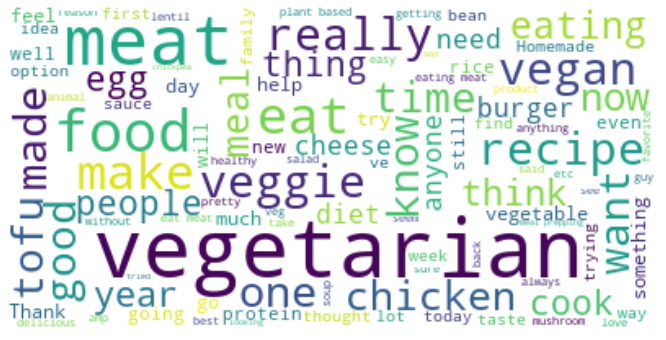

In [87]:
# creating WordCloud - vegposts

from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

#veg_posts

wordcloud_veg = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(' '.join(df_vegX['content']))

# Display the generated image:
plt.figure(figsize=(12,6))
plt.imshow(wordcloud_veg, interpolation='bilinear')
plt.axis("off")
plt.show()

### ii. Getting data from lowimpactlifestlye.csv and examination of data

In [88]:
#getting data from csv file

lil_posts=pd.read_csv('../datasets/lowimpactlifestyle.csv')
lil_posts.head()

,all_awardings,allow_live_comments,approved_at_utc,approved_by,archived,author,author_flair_background_color,author_flair_css_class,author_flair_richtext,author_flair_template_id,author_flair_text,author_flair_text_color,author_flair_type,author_fullname,author_patreon_flair,awarders,banned_at_utc,banned_by,can_gild,can_mod_post,category,clicked,content_categories,contest_mode,created,created_utc,crosspost_parent,crosspost_parent_list,discussion_type,distinguished,domain,downs,edited,gilded,gildings,hidden,hide_score,id,is_crosspostable,is_meta,is_original_content,is_reddit_media_domain,is_robot_indexable,is_self,is_video,likes,link_flair_background_color,link_flair_css_class,link_flair_richtext,link_flair_text,link_flair_text_color,link_flair_type,locked,media,media_embed,media_metadata,media_only,mod_note,mod_reason_by,mod_reason_title,mod_reports,name,no_follow,num_comments,num_crossposts,num_reports,over_18,parent_whitelist_status,permalink,pinned,post_hint,preview,pwls,quarantine,removal_reason,report_reasons,saved,score,secure_media,secure_media_embed,selftext,selftext_html,send_replies,spoiler,steward_reports,stickied,subreddit,subreddit_id,subreddit_name_prefixed,subreddit_subscribers,subreddit_type,suggested_sort,thumbnail,thumbnail_height,thumbnail_width,title,total_awards_received,ups,url,user_reports,view_count,visited,whitelist_status,wls
0,[],False,NaN,NaN,True,ImLivingAmongYou,NaN,NaN,[],NaN,NaN,NaN,text,t2_eui63,False,[],NaN,NaN,False,False,NaN,False,NaN,False,1.506086e+09,1.506057e+09,NaN,NaN,NaN,NaN,reddit.com,0,False,0,{},False,False,71owf3,False,False,False,False,True,False,False,NaN,NaN,NaN,[],NaN,dark,text,False,NaN,{},NaN,False,NaN,NaN,NaN,[],t3_71owf3,False,1,0,NaN,False,NaN,/r/lowimpactlifestyle/comments/71owf3/for_a_more_active_community_you_should_check_out/,False,link,"{'images': [{'source': {'url': 'https://external-preview.redd.it/X3dq7BwWSNeUHhYVAwg9EWZnzdW0rDaEwG8X76Th8PI.jpg?auto=webp&amp;s=41609c39ac55f81573d212eaf4cf408bb74a3170', 'width': 256, 'height': 256}, 'resolutions': [{'url': 'https://external-preview.redd.it/X3dq7BwWSNeUHhYVAwg9EWZnzdW0rDaEwG8X76Th8PI.jpg?width=108&amp;crop=smart&amp;auto=webp&amp;s=eaab9a1dc57aa2e3edfeb2ce2c4b9e3eedd3da34', 'width': 108, 'height': 108}, {'url': 'https://external-preview.redd.it/X3dq7BwWSNeUHhYVAwg9EWZnzdW0rDaEwG8X76Th8PI.jpg?width=216&amp;crop=smart&amp;auto=webp&amp;s=8307239f0452549dfeb0eb1addf72e8b3e2cee14', 'width': 216, 'height': 216}], 'variants': {}, 'id': 'tYcca__B981Md52bBlfvfdo-MlQiCaKlQY9HNUmxlkw'}], 'enabled': False}",NaN,False,NaN,NaN,False,9,NaN,{},NaN,NaN,True,False,[],True,lowimpactlifestyle,t5_2wrx1,r/lowimpactlifestyle,8765,public,NaN,https://a.thumbs.redditmedia.com/yrBDwXEjhGyWxcCO44ZE-0IpZQYm_WCRDp9HvNdxAf0.jpg,140.0,140.0,"For a more active community, you should check out /r/ZeroWaste.",0,9,https://www.reddit.com/r/ZeroWaste/,[],NaN,False,NaN,NaN
1,[],False,NaN,NaN,False,SmexicanINC,NaN,NaN,[],NaN,NaN,NaN,text,t2_6kufn,False,[],NaN,NaN,False,False,NaN,False,NaN,False,1.571127e+09,1.571098e+09,NaN,NaN,NaN,NaN,bambuustore.com,0,False,0,{},False,False,dhzmyv,False,False,False,False,True,False,False,NaN,NaN,NaN,[],NaN,dark,text,False,NaN,{},NaN,False,NaN,NaN,NaN,[],t3_dhzmyv,False,2,0,NaN,False,NaN,/r/lowimpactlifestyle/comments/dhzmyv/bamboo_is_a_highly_sustainable_alternative_to/,False,NaN,NaN,NaN,False,NaN,NaN,False,23,NaN,{},NaN,NaN,True,False,[],False,lowimpactlifestyle,t5_2wrx1,r/lowimpactlifestyle,8765,public,NaN,default,NaN,NaN,"Bamboo is a highly sustainable alternative to plastics, worth considering.",0,23,https://bambuustore.com/pages/why-bamboo,[],NaN,False,NaN,NaN
2,[],False,NaN,NaN,False,SlightPermit,NaN,NaN,[],NaN,NaN,NaN,text,t2_1e79z2yh,False,[],NaN,NaN,False,False,NaN,False,NaN,False,1.571182e+09,1.571154e+09,NaN,NaN,NaN,NaN,kickstarter.com,0,False,0,{},False,False,di9k7o,False,False,False,False,True,False,False,NaN,NaN,NaN,[],NaN,dark,text,False,NaN,{},NaN,False,NaN,NaN,NaN,[],t3_di9k7o,True,0,0,NaN,False,NaN,/r/

In [89]:
lil_posts.shape

(1500, 104)

In [90]:
# checking for duplicates and retaining first instance 

lil_posts[lil_posts.duplicated(['selftext'])] [['name', 'selftext']].sort_values(by='selftext')

,name,selftext
1066,t3_cbtsrt,"\n\nOut of any room in any house, none feels so much like home as the kitchen. The concept of eco-friendly products stresses on the fact that their production and use does not harm the environment. \n\n&amp;#x200B;\n\n[Cotton Kitchen Cloth](https://i.redd.it/mw8027jz8n931.jpg)\n\nAn eco-friendly kitchen is a perfectly attainable goal. Even merely changing a few of your habits will help you to head in the right direction. If you’re concerned about your home’s impact on the environment, you’ll be relieved to know that there are plenty of ways you can make your kitchen a little eco-friendlier. \n\n**How Can We Avoid Plastic in Kitchen?** \n\nBan paper and plastic entirely from your kitchen with reusable produce bags, kitchen towels, and dishcloths. Try the following ideas to get started.\n\n**Ditch the Disposables**\n\nDisposable items use up resources, create waste, and cost extra money. The responsible approach is to include as many green choices as possible. Generally, environmentally friendly products are considered to be expensive in nature, but, in the long run, they actually help you save money. These products last longer and tend to be of high quality and more durable in nature.\n\n**Go Plastic-free**\n\nA plastic-free kitchen space promotes a healthier lifestyle as it eliminates the risk of exposure to harmful chemicals. You’ll find millions of single-use plastic bags discarded each year and most of them end up in a landfill. Off late, there has been an awareness regarding how damaging plastic use can be for the environment. So, anything that you can do to prevent the use of plastic is definitely recommended.\n\n**Use reusable materials**\n\nOne easy way to commit to greener living is vowing to ditch wasteful paper towels in favor of sustainable alternatives like cloth towels and kitchen towels. Reduce the amount of plastic in your kitchen by switching to reusable materials. \n\n&amp;#x200B;\n\n[Cotton Produce Bags](https://i.redd.it/o5pin5up8n931.jpg)\n\nReplace plastic shopping bags for reusable totes and produce bags. [Shop eco-friendly produce bags](https://www.amazon.com/Essentials-Multipurpose-Produce-Drawstring-Closure/dp/B07FKHK72R?ref_=bl_dp_s_web_17894849011) and totes from Daily Home Essentials; take the eco-friendly route.\n\n**Use cloths instead of paper towels**\n\nInstead of paper towels, use Cotton Dishcloths for kitchen cleanups and spills. Reusable cloths mean less waste by saving paper towels from being used and thrown straight into the garbage. To improve your family’s health, make your kitchen a plastic-free zone. \n\n**Get in the habit of Recycle** \n\nRecycling by having a dedicated bin for recyclables in your kitchen. Keep an eye out for plastics with recycling codes #1 and #2 (including containers like soft drinks, salad dressing, milk jugs, and shampoos) - these ones belong in the recycle bin!\n\nKeeping an eye on eco-friendly and sustainable choices doesn’t mean you have to compromise on the beauty and style of your kitchen. [Daily Home Essentials](https://www.amazon.com/stores/node/17894849011?_encoding=UTF8&amp;field-lbr_brands_browse-bin=DAILY%20HOME%20ESSENTIALS&amp;ref_=bl_dp_s_web_17894849011) offers a wide range of premium kitchen essentials – kitchen towels, dishcloths, produce bags, oven mitts and potholders that will bring a zing to your kitchen. Do your part for the earth and make your kitchen a more sustainable place."
766,t3_cbtsrt,"\n\nOut of any room in any house, none feels so much like home as the kitchen. The concept of eco-friendly products stresses on the fact that their production and use does not harm the environment. \n\n&amp;#x200B;\n\n[Cotton Kitchen Cloth](https://i.redd.it/mw8027jz8n931.jpg)\n\nAn eco-friendly kitchen is a perfectly attainable goal. Even merely changing a few of your habits will help you to head in the right direction. If you’re concerned about your home’s impact on the environment, you’ll be relieved to know that there 

In [91]:
# checking for duplicates and keeping first

df_lil = lil_posts[lil_posts.duplicated(['selftext'], keep='first')]
df_lil.shape

(1429, 104)

In [92]:
# identifying content relevant for modelling

df_lilX = df_lil[['title', 'selftext', 'num_comments']]
df_lilX.reset_index(drop=True)
df_lilX.head()

,title,selftext,num_comments
1,"Bamboo is a highly sustainable alternative to plastics, worth considering.",NaN,2
2,"PHOENX - Sustainable Luggage for the conscious traveler, made from recycled and regenerated materials!",NaN,0
3,Non-extreme Minimalism,NaN,1
5,12 Best Palm Oil Free Products You Need for Your Home,NaN,0
6,What alternative to plastic do you use for cat waste?,NaN,20


In [93]:
# null values in selftext observed

df_lilX.isnull().sum()

title           0  
selftext        799
num_comments    0  
dtype: int64

In [94]:
# merging title and selftext to create column 'content' to remove null values

df_lilX['content']=df_lilX[['title', 'selftext']].apply(lambda row: ' '.join(row.values.astype(str)), axis=1)
df_lilX['content']=df_lilX['content'].str.replace('nan', '')
df_lilX.head()

C:\Users\bhavn\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\bhavn\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


,title,selftext,num_comments,content
1,"Bamboo is a highly sustainable alternative to plastics, worth considering.",NaN,2,"Bamboo is a highly sustainable alternative to plastics, worth considering."
2,"PHOENX - Sustainable Luggage for the conscious traveler, made from recycled and regenerated materials!",NaN,0,"PHOENX - Sustainable Luggage for the conscious traveler, made from recycled and regenerated materials!"
3,Non-extreme Minimalism,NaN,1,Non-extreme Minimalism
5,12 Best Palm Oil Free Products You Need for Your Home,NaN,0,12 Best Palm Oil Free Products You Need for Your Home
6,What alternative to plastic do you use for cat waste?,NaN,20,What alternative to plastic do you use for cat waste?


In [95]:
# creating target column for machine learning - 0 for vegetarian posts, 1 for lowimpactlifestlye posts

df_lilX['target']= 1

C:\Users\bhavn\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [96]:
df_lilX.shape

(1429, 5)

In [97]:
# keeping aside 20% of data for testing purposes

df_lilX_train = df_lilX.iloc[ :1200,:]
df_lilX_test = df_lilX.iloc[1201: ,:] 

In [98]:
# final df of subreddit to be used for cleaning, tokenising and lemmatising and modelling

df_lilX_train.shape

(1200, 5)

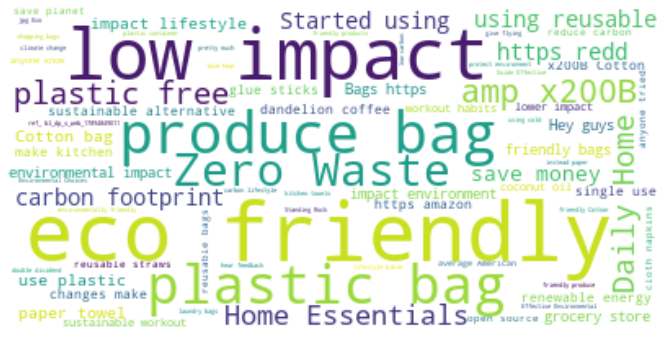

In [99]:

#lil_posts

wordcloud_lil = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(' '.join(df_lilX['content']))

# Display the generated image:
plt.figure(figsize=(12,6))
plt.imshow(wordcloud_lil, interpolation='bilinear')
plt.axis("off")
plt.show()

## 5. Preparation of master dataset

### After cleaning both datasets, the dataframes are combined to give the final dataframe for modelling.
### Only columns 'content' and 'target' are retained and index is reset 

In [124]:
# merging the vegetarian and lowimpactlifestyle datasets

df_master = pd.concat([df_vegX_train, df_lilX_train], ignore_index=True)
df_master.head()

,title,selftext,num_comments,content,target
0,Roasted butternut squash Buddha Bowl,NaN,17,Roasted butternut squash Buddha Bowl,0
1,Entirely plant-based 'Chorizo' Paella!,NaN,2,Entirely plant-based 'Chorizo' Paella!,0
2,100-year-old ballet teacher credits longevity to vegetarianism,NaN,1,100-year-old ballet teacher credits longevity to vegetarianism,0
3,First page of the Menu from a vegetarian restaurant in India,NaN,49,First page of the Menu from a vegetarian restaurant in India,0
4,Now instead of eating too much I just cook too much (recipes in comments),NaN,5,Now instead of eating too much I just cook too much (recipes in comments),0


In [103]:
df_master.to_csv('../datasets/master_data.csv')
df_master.shape

(2000, 5)

In [104]:
# Assigning to variables X and y

X = df_master['content']
y = df_master['target']

In [105]:
#shape of X and y

X.shape, y.shape

((2000,), (2000,))

In [106]:
# What is the accuracy of our baseline model?
y.value_counts(normalize=True)

1    0.6
0    0.4
Name: target, dtype: float64

In [107]:
df_X = pd.DataFrame(X)
df_X.shape

(2000, 1)

In [108]:
# preparing test set for final testing of model

df_test = pd.concat([df_vegX_test, df_lilX_test], ignore_index=True)
df_test

,title,selftext,num_comments,content,target
0,Accidentally eating meat?,My friend and I ordered burritos and hers had chicken in it. Neither of us could finish them and she didn't wanna take it home so she left hers at mine and we went out. I was really hungry when I got back home and went to the fridge to get the rest. I forgot hers had chicken (she normally doesn't eat meat) and I ate some and now I feel sick and have the worst stomach cramps. I've been pescetarian for over 2 years now (I rarely eat fish though. Just for special occasions) and I don't eat much dairy. I was wondering if anyone has had a similar experience or do I just have food poisoning (though my friend isn't sick so I doubt it)?\n\nSide note: meat tastes different now. It's really not as good.,8,Accidentally eating meat? My friend and I ordered burritos and hers had chicken in it. Neither of us could finish them and she didn't wanna take it home so she left hers at mine and we went out. I was really hungry when I got back home and went to the fridge to get the rest. I forgot hers had chicken (she normally doesn't eat meat) and I ate some and now I feel sick and have the worst stomach cramps. I've been pescetarian for over 2 years now (I rarely eat fish though. Just for special occasions) and I don't eat much dairy. I was wondering if anyone has had a similar experience or do I just have food poisoning (though my friend isn't sick so I doubt it)?\n\nSide note: meat tastes different now. It's really not as good.,0
1,Big vegetarian dinners that last a few days or more,"I'm trying to eat less meat, and that means transforming my dinners. I usually avoid red meat and just make something with fish or chicken.\n\nI think i'm gonna start expanding into other options though, like tofu.\n\nDoes anyone have some solid vegetarian recipes that make a large quantity of food you can keep for several days in the fridge?",10,"Big vegetarian dinners that last a few days or more I'm trying to eat less meat, and that means transforming my dinners. I usually avoid red meat and just make something with fish or chicken.\n\nI think i'm gonna start expanding into other options though, like tofu.\n\nDoes anyone have some solid vegetarian recipes that make a large quantity of food you can keep for several days in the fridge?",0
2,"Sustainability of vegetarian diet when accounting for transport, agricultural practices, etc..","So I'll start off that I'm more or less animal-product free, and my reasoning is almost entirely due to the effect that animal agriculture has on the environment. As a biologist in the Midwestern US, I see a lot of it.\n\nRecently, I've started thinking of cost of international transport and use of plastic in a lot of vegetarian/vegan food. Fresh spinach in the winter in Michigan? You better believe Kroger shipped that in from overseas. That box of seitan? 8 layers of plastic wrap between you and that wheaty goodness. Shopping at your local farmer's market isn't always an option year-round.\n\nI'd love to start a discussion on how you all manage the sustainability of your diet (if its a consideration), and maybe learn some ways I can do better in my own life.\n\nGo green^(go white)",7,"Sustainability of vegetarian diet when accounting for transport, agricultural practices, etc.. So I'll start off that I'm more or less animal-product free, and my reasoning is almost entirely due to the effect that animal agriculture has on the environment. As a biologist in the Midwestern US, I see a lot of it.\n\nRecently, I've started thinking of cost of international transport and use of plastic in a lot of vegetarian/vegan food. Fresh spinach in the winter in Michigan? You better believe Kroger shipped that in from overseas. That box of seitan? 8 layers of plastic wrap between you and that wheaty goodness. Shopping at your local farmer's market isn't always an option year-round.\n\nI'd love to start a discussion on how you all manage the sustainability of your diet (if its a

In [109]:
X_test = df_test['content']
y_test = df_test['target']

In [110]:
X_test.shape, y_test.shape

((468,), (468,))

## 6. Preprocessing and Modeling


### i. Tokenisation, Lemmatisation and Stemming

In [111]:

# Instantiate tokenizer
tokenizer = RegexpTokenizer(r'[A-Za-z]\w+')

# Run tokenizer
df_X['content_token'] = df_X['content'].apply(tokenizer.tokenize)

# removing names of subreddits from

df_X.head()

,content,content_token
0,Roasted butternut squash Buddha Bowl,"[Roasted, butternut, squash, Buddha, Bowl]"
1,Entirely plant-based 'Chorizo' Paella!,"[Entirely, plant, based, Chorizo, Paella]"
2,100-year-old ballet teacher credits longevity to vegetarianism,"[year, old, ballet, teacher, credits, longevity, to, vegetarianism]"
3,First page of the Menu from a vegetarian restaurant in India,"[First, page, of, the, Menu, from, vegetarian, restaurant, in, India]"
4,Now instead of eating too much I just cook too much (recipes in comments),"[Now, instead, of, eating, too, much, just, cook, too, much, recipes, in, comments]"


In [112]:
df_X['content_token'] = df_X['content_token'].replace()

In [113]:
# Import lemmatizer
from nltk.stem import WordNetLemmatizer

# Instantiate lemmatizer
lemmatizer = WordNetLemmatizer()

def word_lemmatizer(text):
    lem_text = [lemmatizer.lemmatize (i, 'v') for i in text]
    return lem_text

df_X['content_lemma']= df_X['content_token'].apply( lambda x: word_lemmatizer(x))
df_X.head()


,content,content_token,content_lemma
0,Roasted butternut squash Buddha Bowl,"[Roasted, butternut, squash, Buddha, Bowl]","[Roasted, butternut, squash, Buddha, Bowl]"
1,Entirely plant-based 'Chorizo' Paella!,"[Entirely, plant, based, Chorizo, Paella]","[Entirely, plant, base, Chorizo, Paella]"
2,100-year-old ballet teacher credits longevity to vegetarianism,"[year, old, ballet, teacher, credits, longevity, to, vegetarianism]","[year, old, ballet, teacher, credit, longevity, to, vegetarianism]"
3,First page of the Menu from a vegetarian restaurant in India,"[First, page, of, the, Menu, from, vegetarian, restaurant, in, India]","[First, page, of, the, Menu, from, vegetarian, restaurant, in, India]"
4,Now instead of eating too much I just cook too much (recipes in comments),"[Now, instead, of, eating, too, much, just, cook, too, much, recipes, in, comments]","[Now, instead, of, eat, too, much, just, cook, too, much, recipes, in, comment]"


In [114]:
# import Stemmer
from nltk.stem import PorterStemmer 

# Instantiate Stemmer
stemmer = PorterStemmer()

def word_stemmer(text):
    stem_text = " ".join ((stemmer.stem(i) for i in text))
    return stem_text

df_X['content_stem'] = df_X['content_lemma'].apply(lambda x: word_stemmer(x))
df_X.head()

,content,content_token,content_lemma,content_stem
0,Roasted butternut squash Buddha Bowl,"[Roasted, butternut, squash, Buddha, Bowl]","[Roasted, butternut, squash, Buddha, Bowl]",roast butternut squash buddha bowl
1,Entirely plant-based 'Chorizo' Paella!,"[Entirely, plant, based, Chorizo, Paella]","[Entirely, plant, base, Chorizo, Paella]",entir plant base chorizo paella
2,100-year-old ballet teacher credits longevity to vegetarianism,"[year, old, ballet, teacher, credits, longevity, to, vegetarianism]","[year, old, ballet, teacher, credit, longevity, to, vegetarianism]",year old ballet teacher credit longev to vegetarian
3,First page of the Menu from a vegetarian restaurant in India,"[First, page, of, the, Menu, from, vegetarian, restaurant, in, India]","[First, page, of, the, Menu, from, vegetarian, restaurant, in, India]",first page of the menu from vegetarian restaur in india
4,Now instead of eating too much I just cook too much (recipes in comments),"[Now, instead, of, eating, too, much, just, cook, too, much, recipes, in, comments]","[Now, instead, of, eat, too, much, just, cook, too, much, recipes, in, comment]",now instead of eat too much just cook too much recip in comment


#### While the dataset has been tokenised, lemmatised and stemmed, the model building will use tokenised data. If the model derived from this is found to be of low accuracy, the other datasets will be considered for model building. Also, since the Count Vectorizer and Tfidf are built with code to handle these steps.


In [115]:
# considering 'content_token' as X_alt
# since there does not appear to be much difference in the words after lemmatising and stemming, taking 

X_alt= df_X['content_token'].astype(str)

## 7. Train-test-split of data for model design


### To train the model , we are using 80% of the master dataset, keeping aside 20% for testing purpose. The training data is further split to training and validation sets for cross validation.

### A pipeline with Count Vectorizer and Logistic Regression is used along for Gridsearch to obtain the optimum values of the parameters. The Count Vectorizer is then used at these optimum values of max features and n-gram to get the score and vocabulary. The Term Frequency-Inverse Document Frequency (Tfidf) Vectorizer is another vectorizer considered to vectorize the text for the Classification models. The models will be runon training and validation data before being used on test data (i.e., 20% of data set aside earlier from the original datasets).

### Two models, Naive Bayes and Decision Tree will be used for evaluation of the models.

## i. Applying Gridsearch for Count Vectorizer along with Logistic Regression to get optimum values for parameters

In [116]:
X_alt.shape, y.shape

((2000,), (2000,))

In [117]:
# splitting to train and validation sets for cross validation - for X_alt and y

X_train, X_val, y_train, y_val = train_test_split(X_alt, y, stratify=y, random_state=42)

In [118]:
# preparing pipeline with Gridsearch and Logistic Regression 

pipe = Pipeline([
    ('cvec', CountVectorizer()),
    ('lr', LogisticRegression())
    ])

pipe_params = {
    'cvec__max_features': [2500, 3000, 3500],
    'cvec__min_df': [2, 3],
    'cvec__max_df': [.9, .95],
    'cvec__ngram_range': [(1,1), (1,2)]
}
gs = GridSearchCV(pipe, param_grid=pipe_params, cv=5)
gs.fit(X_train, y_train)
print(gs.best_score_)
gs.best_params_

C:\Users\bhavn\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


0.9913333333333333


{'cvec__max_df': 0.9,
 'cvec__max_features': 3500,
 'cvec__min_df': 2,
 'cvec__ngram_range': (1, 2)}

In [119]:
gs.score(X_train, y_train)

1.0

In [120]:
gs.score(X_val, y_val)

0.986

#### The near perfect scores show that the grid search optimum values gives an overfitted model to both training and validation data

#### Using the optimum parameters of max_features=3500 and ngram_range=(1, 2), the features used in the vocabulary can be viewed

## ii. Applying Count Vectorizer using optimum values for parameters

In [121]:
# applying optimum values to vectorizer = CountVectorizer(max_features=3500, ngram_range=(1, 2) )

cvec = CountVectorizer(ngram_range=(1, 2), 
                       stop_words =text.ENGLISH_STOP_WORDS.union(['vegetarian', 'low', 'impact', 'lifestlye']), 
                       max_features=3500)

# fit-transform training data
cvec_X_train= cvec.fit_transform(X_train)

# transform validation data
cvec_X_val = cvec.transform(X_val)


df_cvec  = pd.DataFrame(cvec.fit_transform(X_train).toarray(),
                   columns=cvec.get_feature_names())
df_cvec.head()

able  absolutely  access  accidentally  accomplishments  \
0  0     0           0       0             0                 
1  0     0           0       0             0                 
2  0     0           0       0             0                 
3  0     0           0       0             0                 
4  0     0           0       0             0                 

   accomplishments figured  accounts  accounts half  action  actions  \
0  0                        0         0              0       0         
1  0                        0         0              0       0         
2  0                        0         0              0       0         
3  0                        0         0              0       0         
4  0                        0         0              0       0         

   actions does  active  active community  activities  actual  actually  \
0  0             0       0                 0           0       0          
1  0             0       0                 0           0       0          
2  0             0       0                 0           0       0          
3  0             0       0                 0           0       0          
4  0             0       0                 0           0       0          

   actually save  adapt  add  add formaldehyde  add remove  added  added list  \
0  0              0      0    0                 0           0      0            
1  0              0      0    0                 0           1      1            
2  0              0      0    0                 0           0      0            
3  0              0      0    0                 0           0      0            
4  0              0      0    0                 0           0      0            

   additional  additional bin  adjusting  advance  advance submissions  \
0  0           0               0          0        0                     
1  0           0               0          0        0                     
2  0           0               0          0        0                     
3  0           0               0          0        0                     
4  0           0               0          0        0                     

   advanced  advice  advice appreciated  advice help  aerogarden  \
0  0         0       0                   0            0            
1  0         0       0                   0            0            
2  0         0       0                   0            0            
3  0         1       1                   0            0            
4  0         0       0                   0            1            

   aerogarden review  affluent  affluent homeless  affordable  ago  \
0  0                  0         0                  0           0     
1  0                  0         0                  0           0     
2  0                  0         0                  0           0     
3  0                  0         0                  0           0     
4  1                  0         0                  0           0     

   ago bought  ago things  air  air quality  alternative  alternative cooking  \
0  0           0           0    0            0            0                     
1  0           0           0    0            0            0                     
2  0           0           0    0            0            0                     
3  0           0           0    0            0            0                     
4  0           0           0    0            0            0                     

   alternative haven  alternative materials  alternative thing  \
0  0                  0                      0                   
1  0                  0                      0                   
2  0                  0                      0                   
3  0                  0                      0                   
4  0                  0                      0                   

   alternative water  alternative ziplock  alternatives  alternatives love  \
0  0                  

In [122]:
cvec.get_feature_names()

['able',
 'absolutely',
 'access',
 'accidentally',
 'accomplishments',
 'accomplishments figured',
 'accounts',
 'accounts half',
 'action',
 'actions',
 'actions does',
 'active',
 'active community',
 'activities',
 'actual',
 'actually',
 'actually save',
 'adapt',
 'add',
 'add formaldehyde',
 'add remove',
 'added',
 'added list',
 'additional',
 'additional bin',
 'adjusting',
 'advance',
 'advance submissions',
 'advanced',
 'advice',
 'advice appreciated',
 'advice help',
 'aerogarden',
 'aerogarden review',
 'affluent',
 'affluent homeless',
 'affordable',
 'ago',
 'ago bought',
 'ago things',
 'air',
 'air quality',
 'alternative',
 'alternative cooking',
 'alternative haven',
 'alternative materials',
 'alternative thing',
 'alternative water',
 'alternative ziplock',
 'alternatives',
 'alternatives love',
 'amazing',
 'amazon',
 'amazon com',
 'american',
 'amp',
 'amp diys',
 'amp eco',
 'amp field',
 'amp gateway',
 'amp keywords',
 'amp non',
 'amp qid',
 'amp rainwater

## iii. Applying Gridsearch for Tfidf Vectorizer along with Logistic Regression to get optimum values for parameters

In [125]:
# preparing pipeline with Gridsearch and Logistic Regression 

pipe = Pipeline([
    ('tvec', TfidfVectorizer()),
    ('lr', LogisticRegression())
    ])

pipe_params = {
    'tvec__max_features': [2500, 3000, 3500],
    'tvec__min_df': [2, 3],
    'tvec__max_df': [.9, .95],
    'tvec__ngram_range': [(1,1), (1,2)]
}
gs = GridSearchCV(pipe, param_grid=pipe_params, cv=5)
gs.fit(X_train, y_train)
print(gs.best_score_)
gs.best_params_

C:\Users\bhavn\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


0.9686666666666667


{'tvec__max_df': 0.9,
 'tvec__max_features': 3000,
 'tvec__min_df': 2,
 'tvec__ngram_range': (1, 1)}

In [126]:
gs.score(X_train, y_train)

0.9946666666666667

In [127]:
gs.score(X_val, y_val)

0.98

## iii. Applying Tfidf Vectorizer using optimum values for parameters

In [128]:
# applying optimum values to vectorizer = Tfidf(max_features=3500, ngram_range=(1, 2) )

tvec = TfidfVectorizer(ngram_range=(1, 1), 
                       stop_words =text.ENGLISH_STOP_WORDS.union(['vegetarian', 'low', 'impact', 'lifestlye']), 
                       max_features=3000,
                       max_df=0.9,
                       min_df= 2,
                        )

# fit-transform training data
tvec_X_train= tvec.fit_transform(X_train)

# transform validation data
tvec_X_val = tvec.transform(X_val)


df_tvec  = pd.DataFrame(tvec.fit_transform(X_train).toarray(),
                   columns=tvec.get_feature_names())
df_tvec.head()

a4  ability  able  absolutely  access  accessibility  accidentally  \
0  0.0  0.0      0.0   0.0         0.0     0.0            0.0            
1  0.0  0.0      0.0   0.0         0.0     0.0            0.0            
2  0.0  0.0      0.0   0.0         0.0     0.0            0.0            
3  0.0  0.0      0.0   0.0         0.0     0.0            0.0            
4  0.0  0.0      0.0   0.0         0.0     0.0            0.0            

   accomplishments  according  accounts  action  actions  active  activities  \
0  0.0              0.0        0.0       0.0     0.0      0.0     0.0          
1  0.0              0.0        0.0       0.0     0.0      0.0     0.0          
2  0.0              0.0        0.0       0.0     0.0      0.0     0.0          
3  0.0              0.0        0.0       0.0     0.0      0.0     0.0          
4  0.0              0.0        0.0       0.0     0.0      0.0     0.0          

   activity  actual  actualhippies  actually  adapt  add     added  addiction  \
0  0.0       0.0     0.0            0.0       0.0    0.0  0.000000  0.0         
1  0.0       0.0     0.0            0.0       0.0    0.0  0.222635  0.0         
2  0.0       0.0     0.0            0.0       0.0    0.0  0.000000  0.0         
3  0.0       0.0     0.0            0.0       0.0    0.0  0.000000  0.0         
4  0.0       0.0     0.0            0.0       0.0    0.0  0.000000  0.0         

   adding  additional  adds  adhd  adjusting  adobo  adopt  adults  advance  \
0  0.0     0.0         0.0   0.0   0.0        0.0    0.0    0.0     0.0       
1  0.0     0.0         0.0   0.0   0.0        0.0    0.0    0.0     0.0       
2  0.0     0.0         0.0   0.0   0.0        0.0    0.0    0.0     0.0       
3  0.0     0.0         0.0   0.0   0.0        0.0    0.0    0.0     0.0       
4  0.0     0.0         0.0   0.0   0.0        0.0    0.0    0.0     0.0       

   advanced  advantages    advice  aee2w5vmlhfjk1eu1  aerogarden  affluent  \
0  0.0       0.0         0.000000  0.0                0.000000    0.0        
1  0.0       0.0         0.000000  0.0                0.000000    0.0        
2  0.0       0.0         0.000000  0.0                0.000000    0.0        
3  0.0       0.0         0.115878  0.0                0.000000    0.0        
4  0.0       0.0         0.000000  0.0                0.441252    0.0        

   affordable  ages  aggregators  ago  agree  agriculture  agriculturists  \
0  0.0         0.0   0.0          0.0  0.0    0.0          0.0              
1  0.0         0.0   0.0          0.0  0.0    0.0          0.0              
2  0.0         0.0   0.0          0.0  0.0    0.0          0.0              
3  0.0         0.0   0.0          0.0  0.0    0.0          0.0              
4  0.0         0.0   0.0          0.0  0.0    0.0          0.0              

   ahead  aine  air   al  alabama  aldi  allowed  almond  aloo  alot  alright  \
0  0.0    0.0   0.0  0.0  0.0      0.0   0.0      0.0     0.0   0.0   0.0       
1  0.0    0.0   0.0  0.0  0.0      0.0   0.0      0.0     0.0   0.0   0.0       
2  0.0    0.0   0.0  0.0  0.0      0.0   0.0      0.0     0.0   0.0   0.0       
3  0.0    0.0   0.0  0.0  0.0      0.0   0.0      0.0     0.0   0.0   0.0       
4  0.0    0.0   0.0  0.0  0.0      0.0   0.0      0.0     0.0   0.0   0.0       

   alt  alternative  alternatives  altogether  amazing  amazon  america  \
0  0.0  0.0          0.0           0.0         0.0      0.0     0.0       
1  0.0  0.0          0.0           0.0         0.0      0.0     0.0       
2  0.0  0.0          0.0           0.0         0.0      0.0     0.0       
3  0.0  0.0          0.0           0.0         0.0      0.0     0.0       
4  0.0  0.0          0.0           0.0         0.0      0.0     0.0       

   american  ammonia  amp  analysis  anchor  anemia  anemic  angry  animal  \
0  0.0       0.0      0.0  0.0       0.0     0.0     0.0     0.0    0.0      
1  0.0       0.0      0.0  0.0       0.0     0.0     0.0     0.0    0.0      
2  0.0      

In [129]:
tvec.get_feature_names()

['a4',
 'ability',
 'able',
 'absolutely',
 'access',
 'accessibility',
 'accidentally',
 'accomplishments',
 'according',
 'accounts',
 'action',
 'actions',
 'active',
 'activities',
 'activity',
 'actual',
 'actualhippies',
 'actually',
 'adapt',
 'add',
 'added',
 'addiction',
 'adding',
 'additional',
 'adds',
 'adhd',
 'adjusting',
 'adobo',
 'adopt',
 'adults',
 'advance',
 'advanced',
 'advantages',
 'advice',
 'aee2w5vmlhfjk1eu1',
 'aerogarden',
 'affluent',
 'affordable',
 'ages',
 'aggregators',
 'ago',
 'agree',
 'agriculture',
 'agriculturists',
 'ahead',
 'aine',
 'air',
 'al',
 'alabama',
 'aldi',
 'allowed',
 'almond',
 'aloo',
 'alot',
 'alright',
 'alt',
 'alternative',
 'alternatives',
 'altogether',
 'amazing',
 'amazon',
 'america',
 'american',
 'ammonia',
 'amp',
 'analysis',
 'anchor',
 'anemia',
 'anemic',
 'angry',
 'animal',
 'animals',
 'animated',
 'annoying',
 'anonymous',
 'answer',
 'anybody',
 'anymore',
 'anyways',
 'ap',
 'apartment',
 'apartments',
 

## iv. Evaluating models

In [131]:
#initiating a dataframe to collect outcomes of evaluations

outcomes ={'Model':('Training score', 'Validation score', 'TN', 'FP', 'FN', 'TP', 'Accuracy', 'Sensitivity', 'Precision', 'f1 score')}
df_outcomes = pd.DataFrame(outcomes)
df_outcomes

,Model
0,Training score
1,Validation score
2,TN
3,FP
4,FN
5,TP
6,Accuracy
7,Sensitivity
8,Precision
9,f1 score


### a. Applying Naive Bayes with Count Vectorizer (CV)

In [132]:
# Import Naive-Bayes model
from sklearn.naive_bayes import MultinomialNB


perform_score=[]

# Instantiate our model
nb = MultinomialNB()

# Fit our model
model_cv_nb = nb.fit(cvec_X_train, y_train)

# Score our model on the training set.
print('Training score:',round(model_cv_nb.score(cvec_X_train, y_train), 4))

# Score our model on the validation set.
print('Validation score:',model_cv_nb.score(cvec_X_val, y_val))

# predicting using cvec_X_val
preds_cvec_nb = model_cv_nb.predict(cvec_X_val)

# calculating probabilities
probabilities_cv_nb = model_cv_nb.predict_proba(cvec_X_val)

# Generate a confusion matrix.
confusion_matrix(y_val, preds_cvec_nb)

tn, fp, fn, tp = confusion_matrix(y_val, preds_cvec_nb).ravel()

print("True Negatives: %s" % tn)
print("False Positives: %s" % fp)
print("False Negatives: %s" % fn)
print("True Positives: %s" % tp)

perform_score=[round(model_cv_nb.score(cvec_X_train, y_train), 4), 
                        model_cv_nb.score(cvec_X_val, y_val), 
                        tn, fp, fn, tp, 
                        round(accuracy_score(y_val, preds_cvec_nb),4),
                        round(recall_score(y_val, preds_cvec_nb),4),
                        round(precision_score(y_val, preds_cvec_nb),4),
                        round(f1_score(y_val, preds_cvec_nb),4)]
                        
# storing values in df_outcomes
df_outcomes['CV_NB']= pd.Series(data=perform_score) 

Training score: 0.9627
Validation score: 0.93
True Negatives: 188
False Positives: 12
False Negatives: 23
True Positives: 277


In [133]:
# drawing of ROC

def roc(probas, true, step=0.01):
    """
    probas should be a numpy array of predict_probas
    true is a pandas series of true labels
    step is the step size for checking thresholds
    """
    
    probas = probas[:,1]         # output of predict_proba() is an array of the probabilities for every class, 
                                 # however only the probabilities for class 1 needed
    true = true.values           # converting class labels from a Pandas Series to a numpy array 
                                 # using the .values attribute
    assert(len(probas) == len(true))    
    
    TPRs = []                    # Setting up empty list of True Positive Rate
    FPRs = []                    # Setting up empty list of False Positive Rate
    
    for i in np.arange(0.0,1.0,step): 
        preds_class = probas > i   
        TP = 0 
        FP = 0
        TN = 0
        FN = 0
        for index in range(len(preds_class)): # comparing each prediction with each true value here

            if preds_class[index] == 1 and true[index] == 1:
                TP += 1
            elif preds_class[index] == 1 and true[index] == 0:
                FP += 1
            elif preds_class[index] == 0 and true[index] == 0:
                TN += 1 
            elif preds_class[index] == 0 and true[index] == 1:
                FN += 1
                
        TPR = TP/(TP + FN) # Calculating TPR and FPR and appending to our lists
        FPR = FP/(FP + TN)
        
        TPRs.append(TPR)
        FPRs.append(FPR)
         
    plt.rcParams['font.size'] = 14
    plt.plot(FPRs, TPRs, color="orange")
    plt.plot([0,1],[0,1], color='navy', lw=2, linestyle='--')
    plt.xlim([-0.2, 1.2])
    plt.ylim([-0.2, 1.2])
    plt.title('Receiver Operating Characteristic')
    plt.xlabel("False Positive Rate (1 - Specificity)")
    plt.ylabel("True Positive Rate (Sensitivity)")
    plt.show();

### b. Applying Naive Bayes with Tfidf Vectorizer

In [134]:
# Instantiate Naive-Bayes
tfidf_nb = MultinomialNB()

# Fit our model!
model_tfidf_nb = nb.fit(tvec_X_train, y_train)

# Score our model on the training set.
print('Train score:',round(model_tfidf_nb.score(tvec_X_train, y_train), 4))


# Score our model on the testing set.
print('Validation score:',model_tfidf_nb.score(tvec_X_val, y_val))

#predicting using tvec_X_val
preds_tfidf_nb = model_tfidf_nb.predict(tvec_X_val)

# calculating probabilities
probabilities_tfidf_nb = model_tfidf_nb.predict_proba(tvec_X_val)

# Generate a confusion matrix.
confusion_matrix(y_val, preds_tfidf_nb)

tn, fp, fn, tp = confusion_matrix(y_val, preds_tfidf_nb).ravel()

print("True Negatives: %s" % tn)
print("False Positives: %s" % fp)
print("False Negatives: %s" % fn)
print("True Positives: %s" % tp)


perform_score=[round(model_tfidf_nb.score(tvec_X_train, y_train), 4), 
                        model_tfidf_nb.score(tvec_X_val, y_val), 
                        tn, fp, fn, tp, 
                        round(accuracy_score(y_val, preds_tfidf_nb),4),
                        round(recall_score(y_val, preds_tfidf_nb),4),
                        round(precision_score(y_val, preds_tfidf_nb),4),
                        round(f1_score(y_val, preds_tfidf_nb),4)]

# storing values in df_outcomes
df_outcomes['TFIDF_NB']= pd.Series(data=perform_score) 

Train score: 0.9873
Validation score: 0.946
True Negatives: 176
False Positives: 24
False Negatives: 3
True Positives: 297


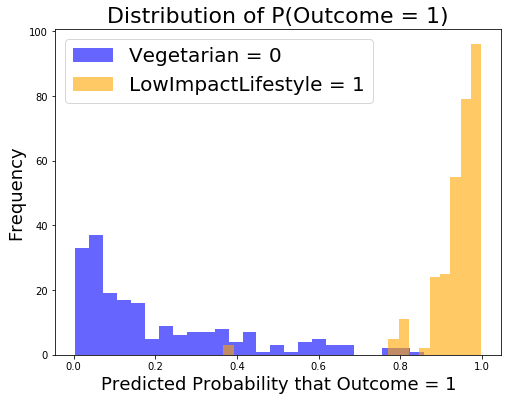

In [135]:
plot_histogram(tvec_X_val, y_val)

Area under Curve: 0.9317


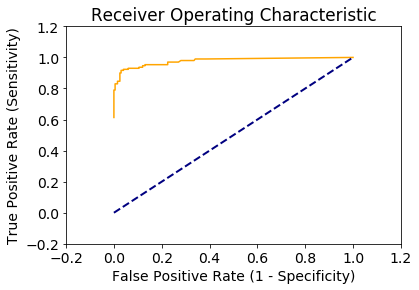

Area under Curve: 0.935


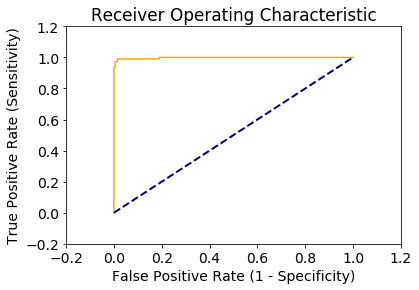

In [136]:
# drawing Receiver Operating Curve for CV_NB validation dataset

print('Area under Curve:', round(roc_auc_score(y_val, preds_cvec_nb),4))
roc(probas = probabilities_cv_nb, true = y_val, step=0.0001); 


print('Area under Curve:', round(roc_auc_score(y_val, preds_tfidf_nb),4))
roc(probas = probabilities_tfidf_nb, true = y_val, step=0.0001); 

#### The Area under Curve for ROC under CV and TFIDF is at 0.9317 and 0.935 respectively, with TFIDF being marginally better.
#### The ROC curve shows the trade-off between sensitivity (or TPR) and specificity (1 – FPR). Classifiers that give curves closer to the top-left corner indicate a better performance. As a baseline, a random classifier is expected to give points lying along the diagonal (FPR = TPR). The closer the curve comes to the 45-degree diagonal of the ROC space, the less accurate the test.*

#### ref: https://www.displayr.com/what-is-a-roc-curve-how-to-interpret-it/





## c. Applying Decision Tree Classifier with Count Vectorizer

### Decision Tree Classifier (DT) was also applied to the training and validation data and the metrics studied


In [137]:
# fitting Decision Tree Classifier to training, validation 

# Instantiate model.
dt = DecisionTreeClassifier(max_depth=50,random_state = 42)

# Fit training data
model_cv_dt = dt.fit(cvec_X_train, y_train)

# Evaluate model.
print(f'Score on training set: {model_cv_dt.score(cvec_X_train, y_train)}')
print(f'Score on validation set: {model_cv_dt.score(cvec_X_val, y_val)}')

# testing for validation set - X_val, y_val
cvec_X_dt = dt.fit(cvec_X_val, y_val)

#predictions
preds_cvec_dt=model_cv_dt.predict(cvec_X_val)

# Generate a confusion matrix.
confusion_matrix(y_val, preds_cvec_dt)

tn, fp, fn, tp = confusion_matrix(y_val, preds_cvec_dt).ravel()

print("True Negatives: %s" % tn)
print("False Positives: %s" % fp)
print("False Negatives: %s" % fn)
print("True Positives: %s" % tp)

perform_score=[round(model_cv_dt.score(cvec_X_train, y_train), 4), 
                        model_cv_dt.score(cvec_X_val, y_val), 
                        tn, fp, fn, tp, 
                        round(accuracy_score(y_val, preds_cvec_dt),4),
                        round(recall_score(y_val, preds_cvec_dt),4),
                        round(precision_score(y_val, preds_cvec_dt),4),
                        round(f1_score(y_val, preds_cvec_dt),4)]

# storing values in df_outcomes
df_outcomes['CV_DT']= pd.Series(data=perform_score) 

Score on training set: 0.9466666666666667
Score on validation set: 0.904
True Negatives: 183
False Positives: 17
False Negatives: 0
True Positives: 300


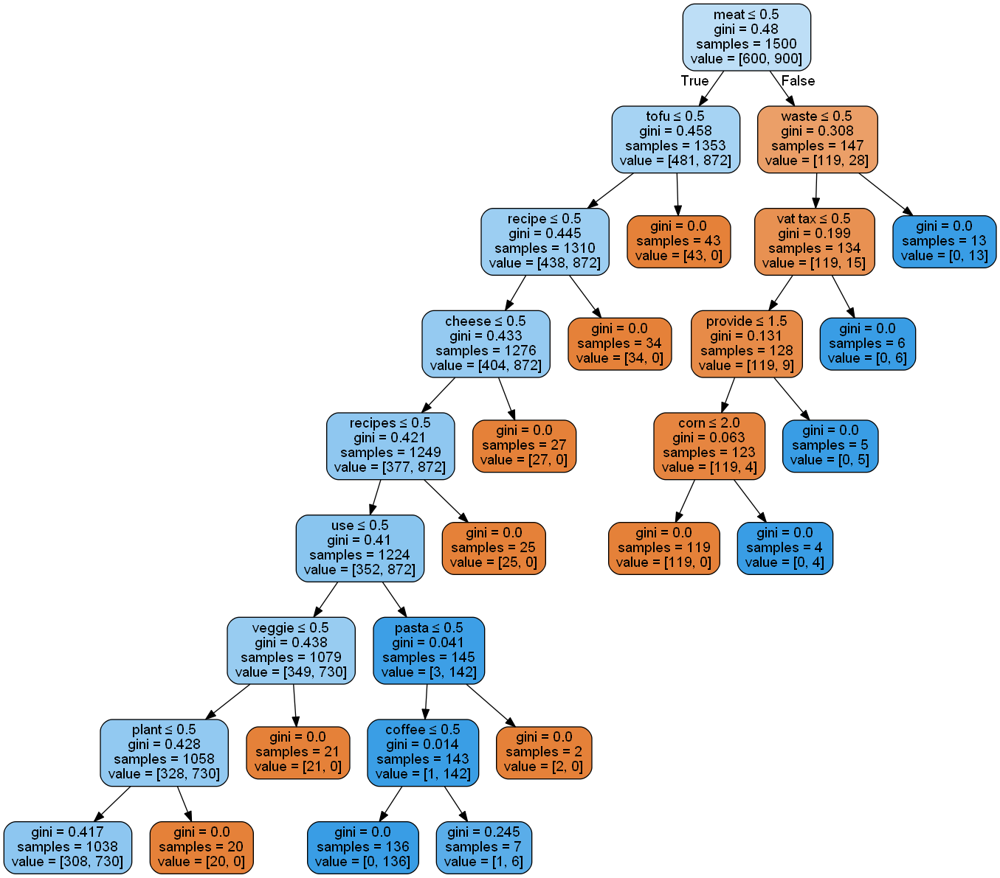

In [138]:
#Create a new tree with a lower depth (easier to visualize)

clf = DecisionTreeClassifier(max_depth = 8)

#tree_data = tvec.fit_transform(X_train['combined'])
clf.fit(cvec_X_train, y_train)
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data, feature_names=cvec.get_feature_names(),
               filled=True, rounded=True,
               special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

### d. Applying Decision Tree with TFIDF

In [139]:
# applying Decision tree to TFIDF to training and validation datasets

from sklearn.tree import DecisionTreeClassifier

# Instantiate model.
dt = DecisionTreeClassifier(max_depth=50,random_state = 42)

# Fit model.
model_tfidf_dt = dt.fit(tvec_X_train, y_train)

# Evaluate model.
print(f'Score on training set: {dt.score(tvec_X_train, y_train)}')
print(f'Score on validation set: {dt.score(tvec_X_val, y_val)}')

#predictions
preds_tfidf_dt=model_tfidf_dt.predict(tvec_X_val)

# Generate a confusion matrix.
confusion_matrix(y_val, preds_tfidf_dt)

tn, fp, fn, tp = confusion_matrix(y_val, preds_tfidf_dt).ravel()

print("True Negatives: %s" % tn)
print("False Positives: %s" % fp)
print("False Negatives: %s" % fn)
print("True Positives: %s" % tp)

perform_score=[round(model_tfidf_dt.score(tvec_X_train, y_train), 4), 
                        model_tfidf_dt.score(tvec_X_val, y_val), 
                        tn, fp, fn, tp, 
                        round(accuracy_score(y_val, preds_tfidf_dt),4),
                        round(recall_score(y_val, preds_tfidf_dt),4),
                        round(precision_score(y_val, preds_tfidf_dt),4),
                        round(f1_score(y_val, preds_tfidf_dt),4)]

# storing values in df_outcomes
df_outcomes['TFIDF_DT']= pd.Series(data=perform_score) 

Score on training set: 0.96
Score on validation set: 0.892
True Negatives: 146
False Positives: 54
False Negatives: 0
True Positives: 300


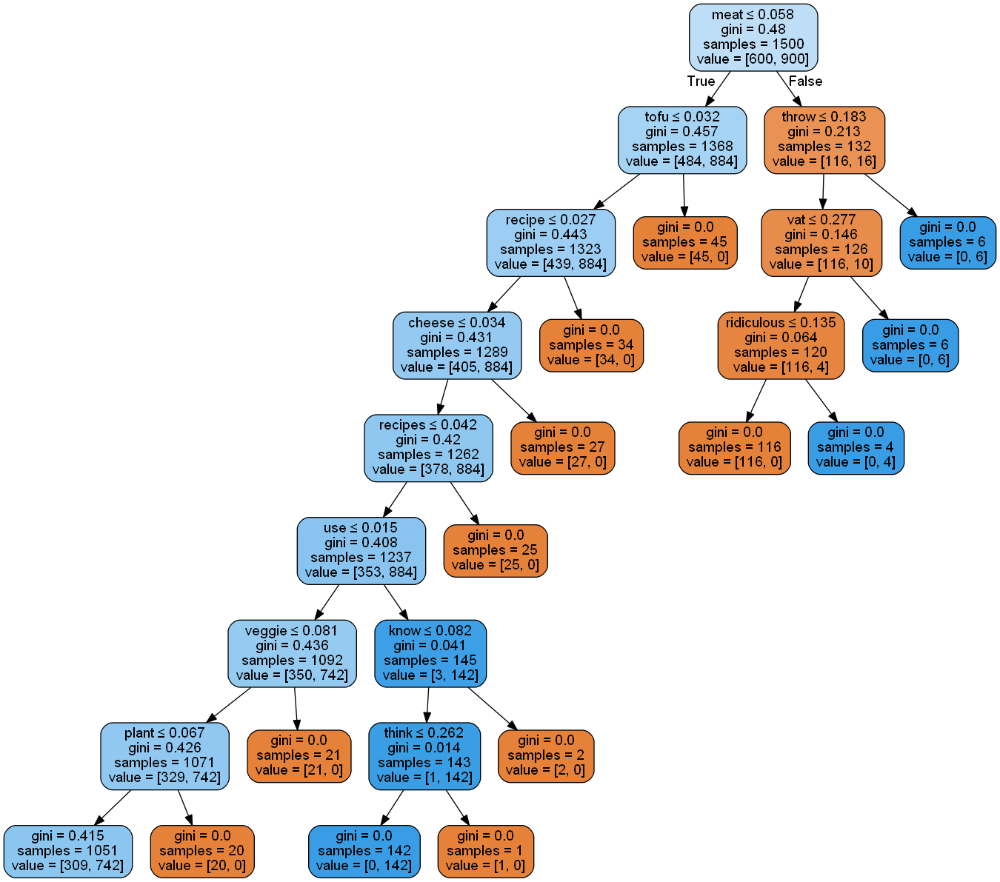

In [140]:
#Create a new tree with a lower depth (easier to visualize)

clf = DecisionTreeClassifier(max_depth = 8)


clf.fit(tvec_X_train, y_train)
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data, feature_names=tvec.get_feature_names(),
               filled=True, rounded=True,
               special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

In [141]:
df_outcomes

,Model,CV_NB,TFIDF_NB,CV_DT,TFIDF_DT
0,Training score,0.9627,0.9873,0.8827,0.9600
1,Validation score,0.9300,0.9460,0.9660,0.8920
2,TN,188.0000,176.0000,183.0000,146.0000
3,FP,12.0000,24.0000,17.0000,54.0000
4,FN,23.0000,3.0000,0.0000,0.0000
5,TP,277.0000,297.0000,300.0000,300.0000
6,Accuracy,0.9300,0.9460,0.9660,0.8920
7,Sensitivity,0.9233,0.9900,1.0000,1.0000
8,Precision,0.9585,0.9252,0.9464,0.8475
9,f1 score,0.9406,0.9565,0.9724,0.9174


### Analysis:
#### - TFIDF-NB has highest Training score and second-highest Validation score
#### -  Although CV-DT has high f1 score, the low training score and large difference in  training and validation scores suggest it is not a strong model
#### - Comparing f1 scores, TFIDF-NB shows as the most promising, since it is second highest. F1 Score is the weighted average of Precision and Recall. Therefore, this score takes both false positives and false negatives into account. Intuitively it is not as easy to understand as accuracy, but F1 is usually more useful than accuracy, especially if you have an uneven class distribution.*

#### The combination of TFIDF Vectorizer and Naive Bayes Classifier is hence selected as the model for testing.

##### * ref: https://blog.exsilio.com/all/accuracy-precision-recall-f1-score-interpretation-of-performance-measures/

## 8. Evaluation of Combination models and selection of model for prediction

#### Comparing the training and validation scores and other metrics, the Count vectorizer with Decision Tree is selected as model to be tested.

In [142]:
# running test data on the selected model - Combination of TFIDF vectorizer with Decision Tree

X_test.shape, y_test.shape

((468,), (468,))

In [143]:
X_test.head()

0    Accidentally eating meat? My friend and I ordered burritos and hers had chicken in it. Neither of us could finish them and she didn't wanna take it home so she left hers at mine and we went out. I was really hungry when I got back home and went to the fridge to get the rest. I forgot hers had chicken (she normally doesn't eat meat) and I ate some and now I feel sick and have the worst stomach cramps. I've been pescetarian for over 2 years now (I rarely eat fish though. Just for special occasions) and I don't eat much dairy. I was wondering if anyone has had a similar experience or do I just have food poisoning (though my friend isn't sick so I doubt it)?\n\nSide note: meat tastes different now. It's really not as good.                                                                                                                                                               
1    Big vegetarian dinners that last a few days or more I'm trying to eat less meat, and that means transf

In [144]:
y_test.head()

0    0
1    0
2    0
3    0
4    0
Name: target, dtype: int64

In [145]:
# fitting TFIDF Vectorizer and Naive Bayes Classifier to test sets

# Vectorising test data
tvec_X_test = tvec.transform(X_test)

#predictions
preds_tfidf_nb_test=model_tfidf_nb.predict(tvec_X_test)

# Score  model on test set.
print('Test score:',model_tfidf_nb.score(tvec_X_test, y_test))

# Generate a confusion matrix.
confusion_matrix(y_test, preds_tfidf_nb_test)

tn, fp, fn, tp = confusion_matrix(y_test, preds_tfidf_nb_test).ravel()

print("True Negatives: %s" % tn)
print("False Positives: %s" % fp)
print("False Negatives: %s" % fn)
print("True Positives: %s" % tp)

perform_score=[round(model_tfidf_nb.score(tvec_X_train, y_train), 4), 
                        model_tfidf_nb.score(tvec_X_test, y_test), 
                        tn, fp, fn, tp, 
                        round(accuracy_score(y_test, preds_tfidf_nb_test),4),
                        round(recall_score(y_test, preds_tfidf_nb_test),4),
                        round(precision_score(y_test, preds_tfidf_nb_test),4),
                        round(f1_score(y_test, preds_tfidf_nb_test),4)]

# storing values in df_outcomes
df_outcomes['TFIDF_NB Test']= pd.Series(data=perform_score) 

Test score: 0.9465811965811965
True Negatives: 217
False Positives: 23
False Negatives: 2
True Positives: 226


In [146]:
df1 =df_outcomes[['Model','TFIDF_NB','TFIDF_NB Test']]
df1

,Model,TFIDF_NB,TFIDF_NB Test
0,Training score,0.9873,0.987300
1,Validation score,0.9460,0.946581
2,TN,176.0000,217.000000
3,FP,24.0000,23.000000
4,FN,3.0000,2.000000
5,TP,297.0000,226.000000
6,Accuracy,0.9460,0.946600
7,Sensitivity,0.9900,0.991200
8,Precision,0.9252,0.907600
9,f1 score,0.9565,0.947600


### Analysis:
#### The testing score is close to the validation score and the f1 score is comparable. There is also a low consistency in the number of False Positives and False Negatives, giving a slightly smaller f1 score than the validation model.  

## 9. Conclusions and application of selected model

In [147]:
# identifying random posts from either Vegetarian or Low Impact Lifestyle subreddits

def identify_subreddit(text, subreddit):
    
    val = tvec.transform(pd.Series(text))
    label=model_tfidf_nb.predict(val)
    print("Original subreddit:", subreddit)
    if label == 1:
        
        print("Text given is from subreddit Low Inpact Lifestyle")
    else:
        print("Text given is from subreddit Vegetarian")
    
identify_subreddit('I’d like to take this time to publicly thank Taco Bell for being so vegetarian-friendly.', 'Vegetarian')  


Original subreddit: Vegetarian
Text given is from subreddit Vegetarian


In [148]:
identify_subreddit("I have created a survey about organic clothing. I plan to start an online business that sells purely organic clothing that is naturally dyed and fair traded. It would be absolutely amazing if you could find time to fill out this short survey. It will help me understand the needs and wants of consumers and what sort of products I should provide. Here's the link to the survey:", 'Low impact Lifestyle')

Original subreddit: Low impact Lifestyle
Text given is from subreddit Low Inpact Lifestyle


In [149]:
identify_subreddit("Hello friends. I've become more aware recently of the environmental issues relating the production and supply of coffee, and also how 'dandelion coffee' (made from ground, roasted dandelion roots) can be a decent substitute.", 'Low Impact Lifestyle')

Original subreddit: Low Impact Lifestyle
Text given is from subreddit Low Inpact Lifestyle


In [150]:
identify_subreddit("Check the package to be sure! If you're transitioning to being a veggie or vegan, this may help with your cravings for comfort food! I was never crazy about bacon, but think some things are better with that smokiness.", 'Vegetarian')

Original subreddit: Vegetarian
Text given is from subreddit Vegetarian


## 9. Conclusion and comments:
#### The TFIDF Vectorizer combined with Naive Bayes Classifier model has demonstrated positive results on recent posts in the subreddits with an accuracy of 94.66%.

#### The whole process of scraping data from the subreddits, cleaning and pre-processing of the data (including selection of relevant columns from the 106 columns of information was completed. In the pre-processing stage, duplicates were dropped and null values overcome by creating a new column content that combined text from the 'title' and 'self-text'. 

#### Models were developed after calculating the optimum values of the parameters involved in the vectorizers. These vectorizers convert text into a binary format, the basic format in which the Machine Learning algorithm can comprehend data. The Vectorizers are bundled with Classifiers that can differentiate two different topics and the efficacy of the model is studied through metrics.

#### In this project, the TDIDF Vectorizer along with Naive Bayes Classifier was found to give the best score and hence selected for testing with unlabelled data. The model scored an average 94.7%

#### On further scrutiny, the overlap of the probabilities of words between the topics was low (a shown in histogram below) and hence the high level of accuracy of the models


#### Limitations: 
#### 1.	The model can only do a binary differentiation after vectorising the words, So it is in an either-or format.    
#### 2.	Model could throw up an error where sentiment is not in line with the content, eg, sarcastic tone of article.


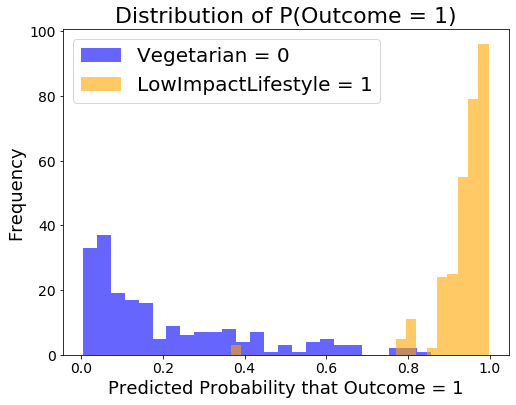

In [152]:
# Plotting of histogram 

def plot_histogram(matrix, y_val):
    pred_proba = [i[1] for i in model_tfidf_nb.predict_proba(tvec_X_val)]

    pred_df = pd.DataFrame({'true_values': y_val,
                            'pred_probs':pred_proba})

    # Create figure.
    plt.figure(figsize = (8,6))

    # Create two histograms of observations.
    plt.hist(pred_df[pred_df['true_values'] == 0]['pred_probs'],
             bins=25,
             color='b',
             alpha = 0.6,
             label='Vegetarian = 0')
    plt.hist(pred_df[pred_df['true_values'] == 1]['pred_probs'],
             bins=25,
             color='orange',
             alpha = 0.6,
             label='LowImpactLifestyle = 1')

    # Label axes.
    plt.title('Distribution of P(Outcome = 1)', fontsize=22)
    plt.ylabel('Frequency', fontsize=18)
    plt.xlabel('Predicted Probability that Outcome = 1', fontsize=18)

    # Create legend.
    plt.legend(fontsize=20);

plot_histogram(tvec_X_val, y_val)